# Plotting brain images

In the [`introductory_tutorial`](introductory_tutorial.ipynb) we ran through building structural covariance network analyses using `scona`🍪.

In this tutorial we'll cover some scona plotting tools for plotting connectome as well as plotting brain images in 3D.

As a result we will have interactive, publication-quality plots.

Click on any of the links below to jump to that section
* [Get set up](#Get-set-up) (make sure to run this section before jumping into any of the others!)
* [Visualise nodes in 3D: `view_nodes_3d`](#Visualise-nodes-in-3D%3A-%3Ccode%3Eview_nodes_3d%3C%2Fcode%3E)
* [Visualise Connectome in 3D: `view_connectome_3d`](#Visualise-Connectome-in-3D%3A %3Ccode%3Eview_connectome_3d%3C%2Fcode%3E)
* [Plot Connectome: `plot_connectome`](#Plot-Connectome%3A-%3Ccode%3Eplot_connectome%3C%2Fcode%3E)

## Get set up

### Import the modules you need

In [1]:
import scona as scn
import scona.datasets as datasets
import numpy as np
import networkx as nx
import pandas as pd
from IPython.display import display

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

%load_ext autoreload
%autoreload 2

### Read in the data, build a network and calculate the network metrics

If you're not sure about this step, please check out the [`introductory_tutorial`](introductory_tutorial.ipynb) notebook for more explanation.

In [2]:
# Read in sample data from the NSPN WhitakerVertes PNAS 2016 paper.
df, names, covars, centroids = datasets.NSPN_WhitakerVertes_PNAS2016.import_data()

# calculate residuals of the matrix df for the columns of names
df_res = scn.create_residuals_df(df, names, covars)

# create a correlation matrix over the columns of df_res
M = scn.create_corrmat(df_res, method='pearson')

# Initialise a weighted graph G from the correlation matrix M
G = scn.BrainNetwork(network=M, parcellation=names, centroids=centroids)

# Threshold G at cost 10 to create a binary graph with 10% as many edges as the complete graph G.
G10 = G.threshold(10)

## Visualise nodes in 3D: `view_nodes_3d`

Insert a 3d plot of nodes in a brain into the jupyter-notebook.

\- [`using nilearn.plotting.view_markers() tool`](http://nilearn.github.io/modules/generated/nilearn.plotting.view_markers.html#nilearn.plotting.view_markers)


Together with plotting anatomical networks, this is a great way to analyze and visualize nodal measures.  
*Tip*: This function is mainly used for interactivity, whereas `plot_anatomical_network` for saving publication-ready plots in a file.

### Look at the data

Display nodes in BrainNetwork Graph G10

In [3]:
# get the number of nodes in G10
G10.number_of_nodes()

308

In [4]:
# show all nodes in G10
G10.nodes()

NodeView((0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 

In [5]:
# Look at the specific node's attributes
G.nodes[12]

{'centroids': array([-33.515847, -72.220765, -14.257923]),
 'name': 'lh_fusiform_part3',
 'x': -33.515847,
 'y': -72.220765,
 'z': -14.257923}

The BrainNetwork Graph G10 has nodal locations in MNI space indexed by nodal attribute "centroids".

In [6]:
# show the nodal attributes of first 10 brain regions
G10.report_nodal_measures().loc[:10]

,name,centroids,x,y,z
0,lh_bankssts_part1,"[-56.40355, -40.152663, 1.708876]",-56.4036,-40.1527,1.70888
1,lh_bankssts_part2,"[-53.140506, -49.843038, 8.264557]",-53.1405,-49.843,8.26456
2,lh_caudalanteriorcingulate_part1,"[-5.001684, 20.645903, 25.733446]",-5.00168,20.6459,25.7334
3,lh_caudalmiddlefrontal_part1,"[-33.265925, 20.200202, 45.347826]",-33.2659,20.2002,45.3478
4,lh_caudalmiddlefrontal_part2,"[-31.958115, 2.146597, 51.26911]",-31.9581,2.1466,51.2691
5,lh_caudalmiddlefrontal_part3,"[-38.795007, 12.584757, 33.278581]",-38.795,12.5848,33.2786
6,lh_caudalmiddlefrontal_part4,"[-39.715079, 11.341351, 48.846438]",-39.7151,11.3414,48.8464
7,lh_cuneus_part1,"[-8.609127, -73.360119, 17.095238]",-8.60913,-73.3601,17.0952
8,lh_cuneus_part2,"[-5.3042, -87.102157, 19.323496]",-5.3042,-87.1022,19.3235
9,lh_entorhinal_part1,"[-24.010774, -5.86141, -32.826641]",-24.0108,-5.86141,-32.8266


### Import the code you need: `view_nodes_3d`

In [7]:
# import the function to plot network measures
from scona.visualisations import view_nodes_3d

/home/pilot/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


### Plot nodes
We only need the BrainNetwork graph to plot nodes.  

*Important*: Graph has to contain nodes coordinates as a nodal attribute "centroids"

#### Default settings

By default, all nodes will be displayed in **black** color with the same size value - **5.0**.

In [8]:
view_nodes_3d(G10)

The great thing is that you are able to: 
- view nodes from different angles (mouse moves)
- view nodes from different orientations (left-botton dropdown list)
- save as a png file (top-right: figure will be downloaded and stored in browser-downloads location)
- edit plot in Plotly:Chart Studio - online editor to modify plot manually specifying nodes location and colors (top-right)
- pan and set different rotations

Explore and find what you need! :)

#### Plot nodes with different sizes and change the default color to "Coral" 

In [9]:
# Now let's randomly generate the size for each node and store values in *sizes* list.

In [10]:
import random

# create empty array to store sizes of nodes
sizes = list()

# set seed value to make random numbers predictable for reproducibility
random.seed(0)

for i in range(len(G10.nodes)):
    
    # generate random number from 5 to 10
    size = random.randrange(5, 10)
    
    # add size of i-th node to the array
    sizes.append(size)

In [11]:
view_nodes_3d(G10, node_color="Coral", node_size=sizes)

By setting the node_size of a node to 0, this node will not be displayed.

In [12]:
# set the size of the even nodes to 0
for i in range(len(sizes)):
    if i % 2 == 0:
        sizes[i] = 0

In [13]:
view_nodes_3d(G10, node_color="Coral", node_size=sizes)

Plot only 1 node.

In [14]:
G.node[12]

{'centroids': array([-33.515847, -72.220765, -14.257923]),
 'name': 'lh_fusiform_part3',
 'x': -33.515847,
 'y': -72.220765,
 'z': -14.257923}

In [15]:
# set the size of all nodes to 0
sizes = [0 for i in range(len(G.nodes()))]

In [16]:
# set the size of 1 node to 12
sizes[12] = 12

In [17]:
view_nodes_3d(G10, node_color="Red", node_size=sizes)

#### Plot nodes in different colors

Let's plot each hemisphere in an individual color.

*Note*: An **x** coordinate of a node determines whether a node belongs to the left or right hemisphere. Negative value of **x** means that node is in left hemisphere, positive - right.

In [18]:
# set 2 colors for nodes in hemispheres
colors = ["#FFD700", "#4169E1"]

In [19]:
# create array to store colors for nodes
nodes_colors = []

# choose a color for each node based on the **x** coordinate
for node in G.nodes():
    if G.nodes[node]["x"] > 0:
        nodes_colors.append(colors[0])
    if G.nodes[node]["x"] < 0:
        nodes_colors.append(colors[1])

In [20]:
view_nodes_3d(G10, node_color=nodes_colors)

### Plot nodes in differene colors according to their nodal measures

First things first, we need to calculate nodal measures.

In [21]:
# calculate nodal measures for graph G10
G10.calculate_nodal_measures()

In [22]:
# store nodes attributes as a DataFrame
nodal_attributes = G10.report_nodal_measures()

# show 10 first nodes
nodal_attributes.iloc[0:10]

,name,centroids,betweenness,closeness,clustering,degree,module,participation_coefficient,shortest_path_length,x,y,z
0,lh_bankssts_part1,"[-56.40355, -40.152663, 1.708876]",0.00824713,0.495961,0.3358,47,0,0.717067,2.00974,-56.4036,-40.1527,1.70888
1,lh_bankssts_part2,"[-53.140506, -49.843038, 8.264557]",0.0124798,0.507438,0.278788,55,0,0.809587,1.96429,-53.1405,-49.843,8.26456
2,lh_caudalanteriorcingulate_part1,"[-5.001684, 20.645903, 25.733446]",0,0.336254,1,2,1,0.75,2.96429,-5.00168,20.6459,25.7334
3,lh_caudalmiddlefrontal_part1,"[-33.265925, 20.200202, 45.347826]",0.0120765,0.525685,0.383485,83,2,0.459864,1.8961,-33.2659,20.2002,45.3478
4,lh_caudalmiddlefrontal_part2,"[-31.958115, 2.146597, 51.26911]",0.0292617,0.549195,0.293617,95,2,0.688753,1.81494,-31.9581,2.1466,51.2691
5,lh_caudalmiddlefrontal_part3,"[-38.795007, 12.584757, 33.278581]",0.00295414,0.472308,0.476411,47,2,0.346311,2.11039,-38.795,12.5848,33.2786
6,lh_caudalmiddlefrontal_part4,"[-39.715079, 11.341351, 48.846438]",0.00683154,0.491987,0.421861,68,2,0.4375,2.02597,-39.7151,11.3414,48.8464
7,lh_cuneus_part1,"[-8.609127, -73.360119, 17.095238]",0.00746329,0.450147,0.431159,24,0,0.609375,2.21429,-8.60913,-73.3601,17.0952
8,lh_cuneus_part2,"[-5.3042, -87.102157, 19.323496]",0.0148828,0.473765,0.403226,32,0,0.647461,2.1039,-5.3042,-87.1022,19.3235
9,lh_entorhinal_part1,"[-24.010774, -5.86141, -32.826641]",0.00657936,0.382316,0.422222,10,1,0.19,2.60714,-24.0108,-5.86141,-32.8266


In [23]:
view_nodes_3d(G10, measure="module", cmap_name="tab10")

Set the **continuous** parameter to **True** in order to plot nodes according to the continuous data of nodal measures (like "closeness", "betweenness" etc).

In [24]:
view_nodes_3d(G10, measure="closeness", cmap_name="hot_r", continuous=True)

## Visualise Connectome in 3D: `view_connectome_3d`

Insert a 3d plot of a connectome into an HTML page/jupyter notebook.

\- [`nilearn.plotting.view_connectome() tool`](http://nilearn.github.io/modules/generated/nilearn.plotting.view_connectome.html#nilearn.plotting.view_connectome)

With the `scone.view_nodes_3d()` tool we were mainly focused to show only nodes and especially nodes visualisation according to their nodal measures. Whereas `view_connectome_3d` tool is essentially used to show the connections between nodes.

That is important to visualise connections between brain regions, that's why we pass to `view_connectome_3d` the **original Graph** (G) created from dataset rather than using thresholded Graph. In case there are too many edges displayed we can limit those by setting threshold parameter - *edge_threshold*.

### Look at the data

In [25]:
# # get the number of edges
G.number_of_edges()

47278

In [26]:
# get the weight of the edge

G.edges[(283, 286)]

{'weight': 0.4568787612062155}

Displaying 47278 edges does not convey any useful information and does not illustrate any findings from brain analysis. Therefore let's set the edge threshold.

**edge_threshold** : str, number or None, optional (default=None)  
If None, no thresholding. If it is a number only connections of amplitude greater than threshold will be shown. If it is a string it must finish with a percent sign, e.g. “25.3%”, and only connections of amplitude above the given percentile will be shown.

### Import the code you need: `view_connectome_3d`

In [27]:
from scona.visualisations import view_connectome_3d

### View Connectome
We only need the BrainNetwork Graph to produce an interactive plot of connectome.  

*Important*: Graph has to contain nodes coordinates as a nodal attribute "centroids".

#### Default settings

By default, all nodes have **3.0** size and all edges are displayed. Color of each edge is chosen based on the *weight* value of an edge. The default colormap for visualising edges - "Spectral_r".

In [28]:
# plot all edges in G

# view_connectome_3d(G)

### View connectome with edge thresholding

To fulfill this goal use parameter *edge_threshold*.  
From documentation:  
> edge_threshold : str, number or None, optional (default=None)  
        If it is a number only connections of amplitude greater than threshold will be shown.  
        If it is a string it must finish with a percent sign,
        e.g. "25.3%", and only connections of amplitude above the
        given percentile will be shown.

So let's display only connections that have weight property higher than value 0.5.

In [29]:
view_connectome_3d(G, edge_threshold=0.5)

### Plot connectome with adjusted colormap

You have probably noticed that the colormap in the above-produced plot is symmetric, which means that the range is from -vmax to vmax. 

To adjust the colormap to be in the interval [0,vmax], set the parameter *symmetric_cmap* to False.


In [30]:
view_connectome_3d(G, edge_threshold=0.5, symmetric_cmap=False)

/home/pilot/anaconda3/lib/python3.6/site-packages/nilearn/plotting/js_plotting_utils.py:201: UserWarning: you have specified symmetric_cmap=False but the map contains negative values; setting symmetric_cmap to True
  warnings.warn('you have specified symmetric_cmap=False '


The colormap of the newly-created plot is identical to the previous one. The reason is that in Graph G there are edges that have negative weights.

In [31]:
# keep the count of negative weights
negative_weights = 0

for edge in G.edges():
    if (G.edges[edge]["weight"]) < 0:
        negative_weights += 1

print("The number of negative weights = ", negative_weights)

The number of negative weights =  102


### View connectome with different parameters

Short description of other parameters:
- edge_cmap - colormap for edges (default "Spectral_r");  
- linewidth - width of edges (default 6.0);  
- node_size - size of nodes (default 3.0;  

In [32]:
view_connectome_3d(G, edge_threshold=0.5, symmetric_cmap=False, edge_cmap="cool", linewidth=3, node_size=3)

/home/pilot/anaconda3/lib/python3.6/site-packages/nilearn/plotting/js_plotting_utils.py:201: UserWarning: you have specified symmetric_cmap=False but the map contains negative values; setting symmetric_cmap to True
  warnings.warn('you have specified symmetric_cmap=False '
/home/pilot/anaconda3/lib/python3.6/site-packages/nilearn/plotting/js_plotting_utils.py:103: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  warnings.warn('It seems you have created more than 10 '


## Plot Connectome 

Plot connectome on top of the brain glass schematics.


\- using [`nilearn.plotting.plot_connectome() tool`](https://nilearn.github.io/modules/generated/nilearn.plotting.plot_connectome.html#nilearn.plotting.plot_connectome)

### Import the code you need: `plot_connectome`

In [33]:
from scona.visualisations import plot_connectome

### Plot Connectome

We only need the BrainNetwork Graph to produce plot of connectome in different orientations.  

*Important*: Graph has to contain nodes coordinates as a nodal attribute "centroids".

#### Default settings

By default, connectome is displayed in the 'ortho' orthogonal directions. Color of each edge is chosen based on the *weight* value of an edge. The default colormap for visualising edges - "bwr" (diverging colormap).

### Look at the data

In [34]:
G10.number_of_nodes()

308

In [35]:
G10.number_of_edges()

4728

*Note*: One can efficiently use this functionality only for a small number of nodes and edges.  

That's why plotting Graph (even thresholded at cost 10) with 308 nodes and 4728 edges is not recommended, as you will not be able to visualise data and results from brain analysis efficiently.

In [36]:
# plot BrainNetwork Graph G, the one constructed from MRI dataset

# plot_connectome(G10)

### Plot high-degree nodes and connections between them

#### Select top 10 nodes with the highest degree values

In [37]:
# get the number of edges incident to each node

degrees = list(dict(G10.degree()).values())

In [38]:
degrees

[47,
 55,
 2,
 83,
 95,
 47,
 68,
 24,
 32,
 10,
 18,
 28,
 53,
 66,
 34,
 59,
 40,
 56,
 41,
 55,
 33,
 28,
 24,
 27,
 6,
 48,
 19,
 13,
 48,
 1,
 4,
 43,
 34,
 34,
 80,
 9,
 32,
 84,
 18,
 84,
 24,
 11,
 58,
 35,
 19,
 11,
 3,
 4,
 1,
 20,
 16,
 22,
 5,
 21,
 10,
 17,
 19,
 41,
 3,
 3,
 43,
 18,
 23,
 31,
 21,
 40,
 72,
 62,
 55,
 10,
 6,
 13,
 7,
 46,
 11,
 54,
 13,
 42,
 22,
 17,
 1,
 18,
 14,
 14,
 18,
 64,
 71,
 17,
 46,
 37,
 7,
 38,
 37,
 26,
 29,
 25,
 13,
 8,
 39,
 16,
 80,
 42,
 63,
 35,
 58,
 50,
 47,
 36,
 19,
 32,
 42,
 71,
 29,
 45,
 65,
 17,
 50,
 30,
 58,
 71,
 61,
 41,
 53,
 38,
 28,
 63,
 61,
 26,
 64,
 44,
 52,
 4,
 6,
 9,
 5,
 13,
 12,
 10,
 30,
 12,
 11,
 2,
 14,
 8,
 38,
 21,
 9,
 4,
 25,
 2,
 9,
 11,
 20,
 17,
 1,
 30,
 81,
 43,
 55,
 66,
 9,
 13,
 11,
 19,
 6,
 16,
 16,
 14,
 17,
 55,
 30,
 69,
 36,
 45,
 20,
 13,
 30,
 7,
 33,
 8,
 72,
 38,
 29,
 2,
 4,
 7,
 30,
 20,
 57,
 28,
 91,
 11,
 20,
 42,
 19,
 34,
 26,
 49,
 5,
 4,
 11,
 3,
 6,
 14,
 16,
 10,
 19,
 20

In [39]:
# get the nodes that have the most connections to other nodes

def Nmaxelements(degrees, N):
    """
    Choose top <N> largest values in degrees list
    """
    final_list = [] 
  
    for i in range(0, N):  
        
        # find max
        max1 = 0
        for j in range(len(degrees)):      
            if degrees[j] > max1: 
                max1 = degrees[j]
        
        # get the index of max value
        index = degrees.index(max1)
        
        # set the index of max value to 0 in order not to break the order
        degrees[index] = 0
        
        # store the node (index) that has the max value
        final_list.append(index) 
    
    return final_list

In [40]:
# select 10 most well-connected nodes in Graph G10

TopDegreeNodes = Nmaxelements(degrees, 10)

In [41]:
TopDegreeNodes

[278, 280, 4, 190, 37, 39, 3, 156, 34, 100]

By using [`networkx.Graph.subgraph`](https://networkx.github.io/documentation/stable/reference/classes/generated/networkx.Graph.subgraph.html) we create a new Graph that contains only indicated nodes and the edges between those nodes.

In [42]:
# create a new Graph that contains nodes stored in "TopDegreeNodes" list and connections between them

new_Graph = G10.subgraph(TopDegreeNodes)

In [43]:
type(new_Graph)

scona.classes.BrainNetwork

In [44]:
# get the nodes in the new Graph

new_Graph.nodes()

NodeView((34, 3, 4, 37, 100, 39, 278, 280, 156, 190))

In [45]:
# get the edges in the new Graph

new_Graph.edges()

EdgeView([(34, 37), (34, 39), (34, 278), (34, 190), (34, 280), (34, 4), (34, 3), (3, 100), (3, 156), (3, 4), (3, 280), (3, 39), (3, 37), (4, 156), (4, 278), (4, 100), (4, 37), (4, 280), (4, 190), (37, 39), (37, 190), (37, 278), (37, 280), (37, 100), (37, 156), (100, 156), (100, 39), (100, 190), (100, 280), (39, 280), (39, 190), (39, 278), (39, 156), (278, 280), (278, 190), (278, 156), (280, 190), (280, 156), (156, 190)])

In [46]:
new_Graph.edges[34,190]

{'weight': 1}

Now we have created a new Graph that can be easily visualised by calling `plot_connectome`

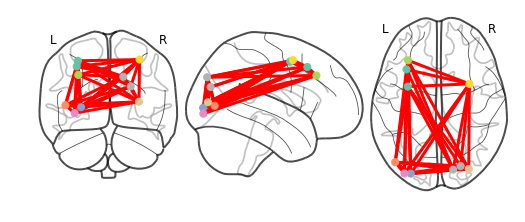

In [47]:
plot_connectome(new_Graph)

There are a bunch of parameters to to adjust the plot according to your preferences.  

For example, let's plot edges in other color than red and reduce the edgewidth.

All edges are plotted in red color, because the *weight* of each node equals to 1. That's why the default colormap used for representing the strength of the edges maps each node to the "maximum" color - red.

In [48]:
for edge in new_Graph.edges():
    print("The weight of the edge {} is {}".format(edge, new_Graph.edges[edge]["weight"]))

The weight of the edge (34, 37) is 1
The weight of the edge (34, 39) is 1
The weight of the edge (34, 278) is 1
The weight of the edge (34, 190) is 1
The weight of the edge (34, 280) is 1
The weight of the edge (34, 4) is 1
The weight of the edge (34, 3) is 1
The weight of the edge (3, 100) is 1
The weight of the edge (3, 156) is 1
The weight of the edge (3, 4) is 1
The weight of the edge (3, 280) is 1
The weight of the edge (3, 39) is 1
The weight of the edge (3, 37) is 1
The weight of the edge (4, 156) is 1
The weight of the edge (4, 278) is 1
The weight of the edge (4, 100) is 1
The weight of the edge (4, 37) is 1
The weight of the edge (4, 280) is 1
The weight of the edge (4, 190) is 1
The weight of the edge (37, 39) is 1
The weight of the edge (37, 190) is 1
The weight of the edge (37, 278) is 1
The weight of the edge (37, 280) is 1
The weight of the edge (37, 100) is 1
The weight of the edge (37, 156) is 1
The weight of the edge (100, 156) is 1
The weight of the edge (100, 39) is

Changing the colormap to "Spectral" will plot all edges in - "dark purple" color - the "maximum" color in "Spectral" colormap.

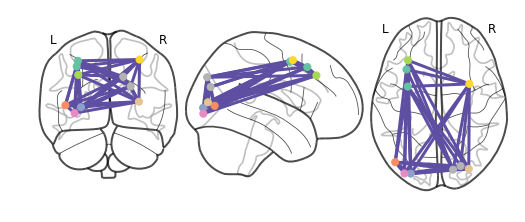

In [49]:
plot_connectome(new_Graph, edge_cmap="Spectral")

But to change the edgewidth we need to pass *edge_kwargs* parameter, which is represented as a dictionary.  

In [50]:
# dict to store the parameters for edges
edge_params = {}

In [51]:
edge_params["linewidth"] = 2

And by passing *edge_kwargs* parameter to `plot_connectome` we can also indicate the color of edges.

In [52]:
edge_params["color"] = "lightblue"

### Modified Plot of high-degree nodes and connections between them

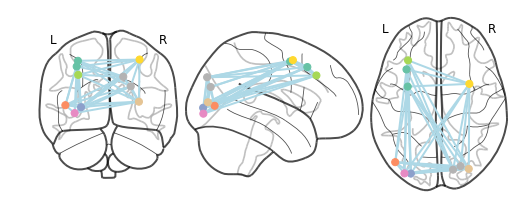

In [53]:
plot_connectome(new_Graph, edge_kwargs=edge_params)

### Plot connectome with different parameters

Short description of other parameters:
- output_file - The name of an image file to export the plot to;  
*Note*: plot will be saved to the given path and it will not be displayed in the notebook.  
By default, plot will be saved in the png format in the current directory unless the full path is given.   
  
- display_mode - Choose the direction of the cuts;  

- black_bg - If True, the background of the image is set to be black;

- node_color - color(s) of the nodes, if array, make sure to have the same length of node_color as the number of nodes;

- node_size - size(s) of the nodes;

Plot top 10 well-connected nodes in *'l' - sagittal left hemisphere only*, in *'z' - axial* and in *'r' - sagittal right hemisphere only* orientations;   
Plot in the black background;  
Use colors from current seaborn palette to plot nodes;  
Change the default size (50) of nodes to 70;  


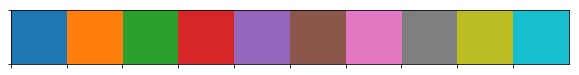

In [54]:
# get the colors from seaborn palette
current_palette = sns.color_palette()

# show colors in palette
sns.palplot(current_palette)

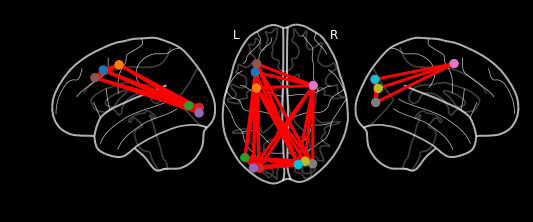

In [55]:
# plot connectome with different parameters

plot_connectome(new_Graph, display_mode="lzr", black_bg=True, node_color=current_palette, node_size=70)